# Requirements

In [1]:
import pandas as pd
import spotipy
from spotipy.oauth2 import SpotifyOAuth
from spotipy.oauth2 import SpotifyClientCredentials
import matplotlib.pyplot as plt
import plotly.express as px
from skimage import io
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.preprocessing import OneHotEncoder
from sklearn.cluster import KMeans
from sklearn.metrics.pairwise import euclidean_distances
from sklearn.metrics import silhouette_score
import numpy as np
from collections import defaultdict
from scipy.spatial.distance import cdist
import os

# Global variables

In [4]:
CLIENT_ID = os.environ.get('CLIENT_ID')
CLIENT_SECRET = os.environ.get('CLIENT_SECRET')
SEED = 1224

# Autenticação da api do spotify

In [150]:
scope = "user-library-read playlist-modify-private"
OAuth = SpotifyOAuth(
        scope=scope,         
        redirect_uri='http://localhost:5000/callback',
        client_id = CLIENT_ID,
        client_secret = CLIENT_SECRET)

client_credentials_manager = SpotifyClientCredentials(
    client_id = CLIENT_ID,
    client_secret = CLIENT_SECRET)


sp = spotipy.Spotify(client_credentials_manager = client_credentials_manager)

# Mastertables

In [161]:
data = pd.read_csv('./kaggle/data.csv')

In [126]:
data_by_genres = pd.read_csv('./kaggle/data_by_genres.csv')

# Modelagem

## Clusterização por gênero

In [127]:
genre_mastertable = data_by_genres.drop(['mode', 'genres'], axis=1)
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2, random_state=SEED))])
genre_embedding_pca = pca_pipeline.fit_transform(genre_mastertable)
transformed_genre_mastertable = pd.DataFrame(columns=['x', 'y'], data=genre_embedding_pca)

In [128]:
kmeans_pca = KMeans(n_clusters=5, verbose=True, random_state=SEED)
kmeans_pca.fit(transformed_genre_mastertable)
data_by_genres['cluster_pca'] = kmeans_pca.predict(transformed_genre_mastertable)
transformed_genre_mastertable['cluster_pca'] = kmeans_pca.predict(transformed_genre_mastertable)

Initialization complete
Iteration 0, inertia 4925.510210854354.
Iteration 1, inertia 3917.620781350889.
Iteration 2, inertia 3727.7196099364655.
Iteration 3, inertia 3633.499679879911.
Iteration 4, inertia 3591.6607182564253.
Iteration 5, inertia 3567.988210155434.
Iteration 6, inertia 3554.9358211191093.
Iteration 7, inertia 3548.8135424299253.
Iteration 8, inertia 3544.0137142979916.
Iteration 9, inertia 3540.362188249829.
Iteration 10, inertia 3536.7065026406826.
Iteration 11, inertia 3531.391327484241.
Iteration 12, inertia 3527.687233283027.
Iteration 13, inertia 3525.2601315402326.
Iteration 14, inertia 3522.6726219596167.
Iteration 15, inertia 3520.271186747494.
Iteration 16, inertia 3518.551735209774.
Iteration 17, inertia 3516.5565021363764.
Iteration 18, inertia 3514.8486081540977.
Iteration 19, inertia 3514.3633472129136.
Converged at iteration 19: center shift 0.00019431865443278603 within tolerance 0.00027162799043829505.


In [129]:
transformed_genre_mastertable['generos'] = data_by_genres['genres']
transformed_genre_mastertable

,x,y,cluster_pca,generos
0,5.896406,-0.006806,2,21st century classical
1,2.801172,4.496443,1,432hz
2,-0.776968,-1.256120,0,8-bit
3,0.996612,-0.927628,3,[]
4,0.731901,-0.996864,3,a cappella
...,...,...,...,...
2968,-0.535344,-0.009162,4,zolo
2969,-3.039611,-1.305249,0,zouglou
2970,-0.810297,-1.093828,0,zouk
2971,1.749906,-3.690534,3,zurich indie


In [130]:
fig = px.scatter(transformed_genre_mastertable, x='x', y='y', color='cluster_pca', hover_data=['x', 'y', 'generos'])
fig.show()

## Clusterização por música

In [131]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), ('kmeans', KMeans(n_clusters=50, verbose=False, random_state=SEED))], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [132]:
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2, random_state=SEED))])
song_embedding = pca_pipeline.fit_transform(X)
music_transformed_mastertable = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
music_transformed_mastertable['title'] = data['name']
music_transformed_mastertable['cluster'] = data['cluster_label']

In [133]:
fig = px.scatter(
    music_transformed_mastertable, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# Sistema de recomendação

In [251]:
def get_10_closest_songs(music_name):
  if music_name in music_transformed_mastertable['title'].to_list():
    recommended_music = music_transformed_mastertable[['x', 'y', 'title']]
    x_music = list(music_transformed_mastertable[music_transformed_mastertable['title'] == music_name]['x'])[0]
    y_music = list(music_transformed_mastertable[music_transformed_mastertable['title'] == music_name]['y'])[1]
    distances = euclidean_distances(recommended_music[['x', 'y']], [[x_music, y_music]])
    recommended_music['id'] = data['id']
    recommended_music['distances'] = distances
    recommended = recommended_music.sort_values('distances').drop_duplicates()

    return recommended.head(10)
  else:
    print('This song is unavailable.')

In [221]:
def display_album_covers(playlist_id):
  url = []
  name = []
  for i in playlist_id:
      track = sp.track(i)
      url.append(track["album"]["images"][1]["url"])
      name.append(track["name"])

# ## Plotando as figuras
  plt.figure(figsize=(15,10))
  columns = 5
  for i, u in enumerate(url):
      ax = plt.subplot(len(url) // columns + 1, columns, i + 1)
      image = io.imread(u)
      plt.imshow(image)
      ax.get_yaxis().set_visible(False)
      plt.xticks(color = 'w', fontsize = 0.1)
      plt.yticks(color = 'w', fontsize = 0.1)
      plt.xlabel(name[i], fontsize = 8,c='black')
      plt.tight_layout(h_pad=0.7, w_pad=0)
      plt.subplots_adjust(wspace=None, hspace=None)
      plt.grid(visible=False)
      plt.tick_params(bottom = False)
  plt.show()

In [222]:
def recommendation_system(music_name):
    recommended_songs = get_10_closest_songs(music_name)
    playlist_id = recommended_songs['id']

    return display_album_covers(playlist_id)

### Aplicando recomendador

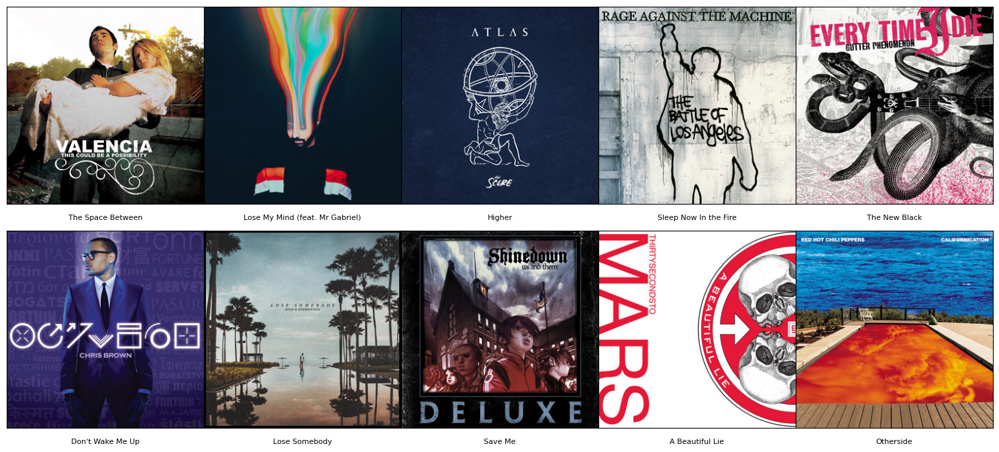

In [249]:
recommendation_system('Complicated')

# Métricas

In [285]:
X = data.select_dtypes(np.number)
kmeans_songs = song_cluster_pipeline.steps[1][1]
labels = kmeans_songs.labels_
score = silhouette_score(X, labels)
score

-0.3207152367226376

In [290]:

labels = kmeans_pca.labels_
score = silhouette_score(transformed_genre_mastertable.select_dtypes(np.number), labels)
score

0.5836041170582404